<a href="https://colab.research.google.com/github/FCardellino/DiploDatos-NoSupervizado/blob/main/Entregable_v1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [70]:
!pip install dataprep

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [71]:
import numpy as np
import pandas as pd
pd.set_option('display.max_columns',100)
pd.set_option('display.max_rows',1000)
import itertools
import warnings
warnings.filterwarnings("ignore")
import io
from plotly.offline import init_notebook_mode, plot,iplot
import plotly.graph_objs as go
init_notebook_mode(connected=True)
import matplotlib.pyplot as plt
import plotly.tools as tls#visualization
import plotly.figure_factory as ff#visualization
import seaborn as sns

In [72]:
from sklearn.cluster import KMeans,MeanShift
from sklearn import decomposition

In [73]:
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import normalize
from sklearn.decomposition import PCA

In [74]:
# Load the Drive helper and mount
from google.colab import drive

# This will prompt for authorization.
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [75]:
from dataprep.datasets import load_dataset   # Used to import / load dataset
from dataprep.eda import create_report   # Used to load Report formate
#import numpy as np     # Importing Python Library
#df = load_dataset("titanic")      # defining dataset

In [76]:
!ls '/content/drive/MyDrive/DiploDatos/players_22.csv'

/content/drive/MyDrive/DiploDatos/players_22.csv


In [77]:
df=pd.read_csv('/content/drive/MyDrive/DiploDatos/players_22.csv')

#1)Analisis exploratorio del dataset

Se genera un repaorte para una primer visualización general del dataset, con los datos sin ningún tratamiento previo

DataPrep Report
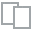
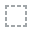
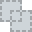
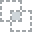
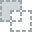
...
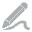
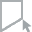
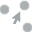
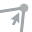
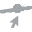

In [14]:
#  Generate Detailed EDA report with sigle line of code 
create_report(df)

Tal como se obseva en el overview del reporte, existe una gran cantidad de datos faltantes, por lo que en el siguiente punto se realizara un primer preprocesamiento del dataset para luego proceder a la evaluación visual de las variables numéricas

#2)Evaluación visual  e intuitiva de a dos variables numéricas por vez.

##Preparación de los datos:


Primero se verifica si existen datos nulos

In [83]:
data=df
nans = data.isna().sum().sort_values(ascending=False)
print(nans[nans!=0]/data.shape[0])

club_joined      0.060450
club_name        0.003171
club_flag_url    0.003171
club_logo_url    0.003171
club_position    0.003171
league_name      0.003171
dtype: float64


A continuación se obtienen aquellas columnas que tengan más del 50% de valores perdidos para luego quitarlas

In [84]:
drop_vars = nans[list(nans/data.shape[0] > 0.5)].keys()
for var in drop_vars:
    print(var)
    data.drop(var,inplace=True,axis=1)

Para los valores nulos/perdidos que aún se encuentren en el dataset, se proceder a imputarlos calculando la media de los datos existentes

In [85]:
data.fillna(data.mean(numeric_only=True), inplace=True)

A los fines de hacer más claro el analisis posterior de los cluster se suma una nueva columna al dataset para agrupar a los jugadores en posiciones más genéricas que las que figuran en la columna "player_position"

In [86]:
forwards=['RF', 'ST', 'LW', 'LF', 'RS', 'LS', 'RM', 'LM','RW']
midfielders=['RCM','LCM','LDM','CAM','CDM','LAM','RDM','CM','RAM','CF']
defenders=['RCB','CB','LCB','LB','RB','RWB','LWB']
goalkeepers=['GK']

def pos2(position):
    position = position.split(',')[0]
    if position in forwards:
        return 'Forward'
    
    elif position in midfielders:
        return 'Midfielder'
    
    elif position in defenders:
        return 'Defender'
    
    elif position in goalkeepers:
        return 'GK'
    
    else:
        return 'nan'         

In [87]:
data["position_group"]=data["player_positions"].apply(lambda x: pos2(x))

En las siguientes lineas separamos las columnas categoricas y las numéricas.

In [89]:
# Identificamos las variables categoricas
categorical_variables = ['sofifa_id',
 'player_url',
 'short_name',
 'long_name',
 'player_positions',
 'dob',
 'club_team_id',
 'club_name',
 'league_name',
 'league_level',
 'club_position',
 'club_jersey_number',
 'club_joined',
 'club_contract_valid_until',
 'nationality_id',
 'nationality_name',
 'preferred_foot',
 'weak_foot',
 'skill_moves',
 'international_reputation',
 'work_rate',
 'body_type',
 'real_face',
 'ls',
 'st',
 'rs',
 'lw',
 'lf',
 'cf',
 'rf',
 'rw',
 'lam',
 'cam',
 'ram',
 'lm',
 'lcm',
 'cm',
 'rcm',
 'rm',
 'lwb',
 'ldm',
 'cdm',
 'rdm',
 'rwb',
 'lb',
 'lcb',
 'cb',
 'rcb',
 'rb',
 'gk',
 'player_face_url',
 'club_logo_url',
 'club_flag_url',
 'nation_flag_url',
 'position_group']

# Para valores del archivo de datos que caen en las columnas que identificamos como categóricas, pasamos estos valores a objeto. En caso que 
# no sean categóricas, las pasamos a variables numéricas reales (float)
for val in data:
    if val in categorical_variables:
        data[val]=data[val].astype('object')
    else:
        pd.to_numeric(data[val], downcast="float")

In [90]:
df_numerical_columns = data.loc[:,data.dtypes != 'object']
df_numerical_columns.columns

Index(['overall', 'potential', 'value_eur', 'wage_eur', 'age', 'height_cm',
       'weight_kg', 'release_clause_eur', 'pace', 'shooting', 'passing',
       'dribbling', 'defending', 'physic', 'attacking_crossing',
       'attacking_finishing', 'attacking_heading_accuracy',
       'attacking_short_passing', 'attacking_volleys', 'skill_dribbling',
       'skill_curve', 'skill_fk_accuracy', 'skill_long_passing',
       'skill_ball_control', 'movement_acceleration', 'movement_sprint_speed',
       'movement_agility', 'movement_reactions', 'movement_balance',
       'power_shot_power', 'power_jumping', 'power_stamina', 'power_strength',
       'power_long_shots', 'mentality_aggression', 'mentality_interceptions',
       'mentality_positioning', 'mentality_vision', 'mentality_penalties',
       'mentality_composure', 'defending_marking_awareness',
       'defending_standing_tackle', 'defending_sliding_tackle',
       'goalkeeping_diving', 'goalkeeping_handling', 'goalkeeping_kicking',
      

In [91]:
position = data['position_group']

Como primer aproximación a la evaluación visual de las variables numéricas, generamos un mapa de calor para tener un panorama general de los correlaciones entre las variables:

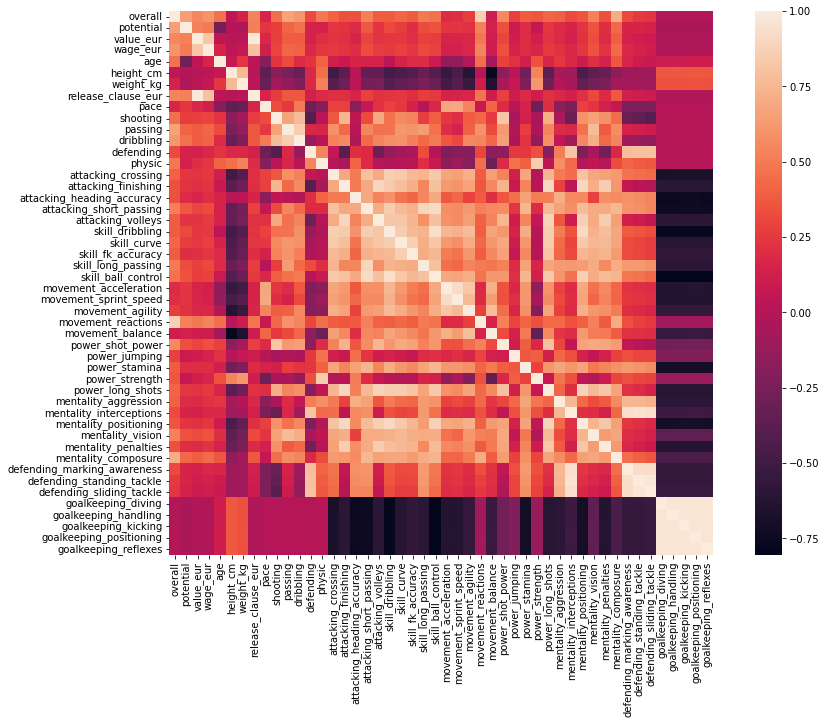

In [92]:
fig = plt.figure(figsize=(15,10))
sns.heatmap(df_numerical_columns.corr(),square=True)
plt.savefig('corr_matrix.jpg', bbox_inches = 'tight')

En las siguientes líneas de código procederemos a hacer una comparación entre las variables numéricas. A los fines de hacer un análisis más ordenado, optamos por ir comparandolas en forma abrupada en base a la keyword (indicativa del tipo de skill) que les antecede en el nombre:

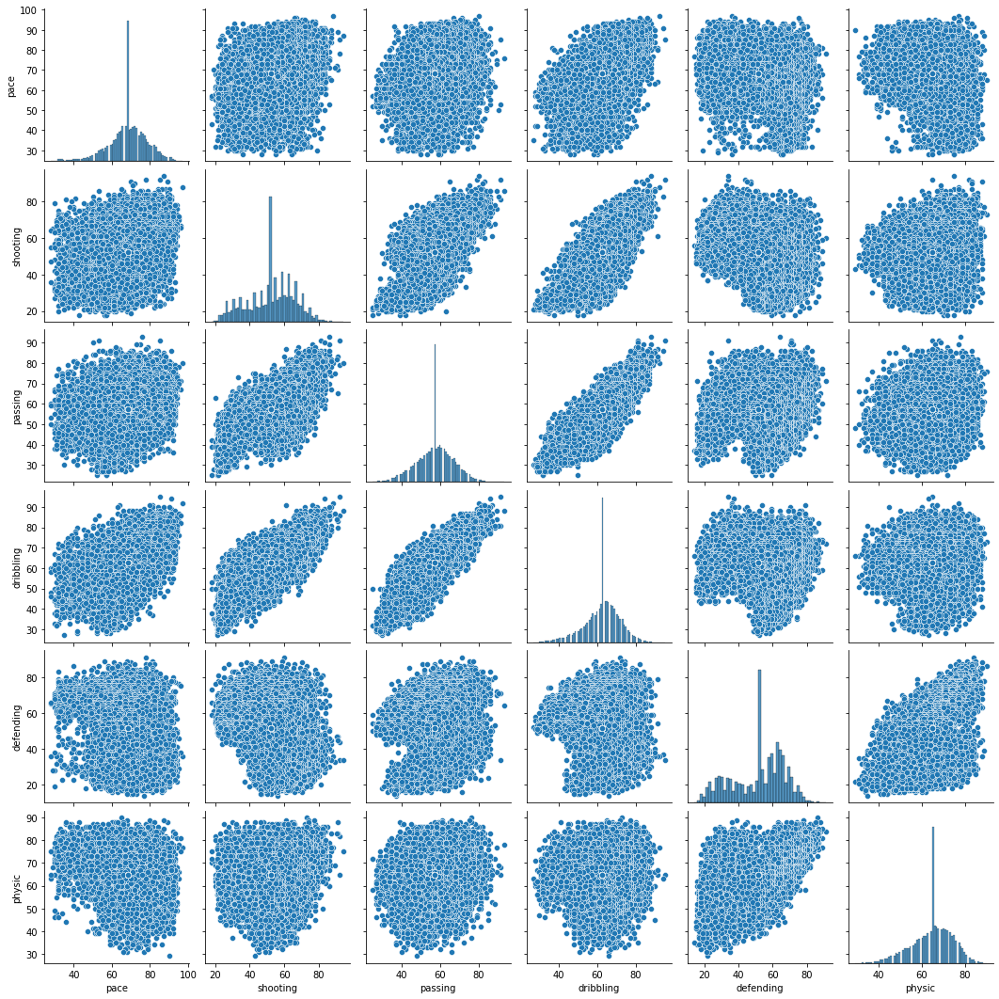

In [93]:
col = ['pace', 'shooting', 'passing',
       'dribbling', 'defending', 'physic']
dat = df_numerical_columns[col]
sns.pairplot(dat)

<Figure size 720x720 with 0 Axes>

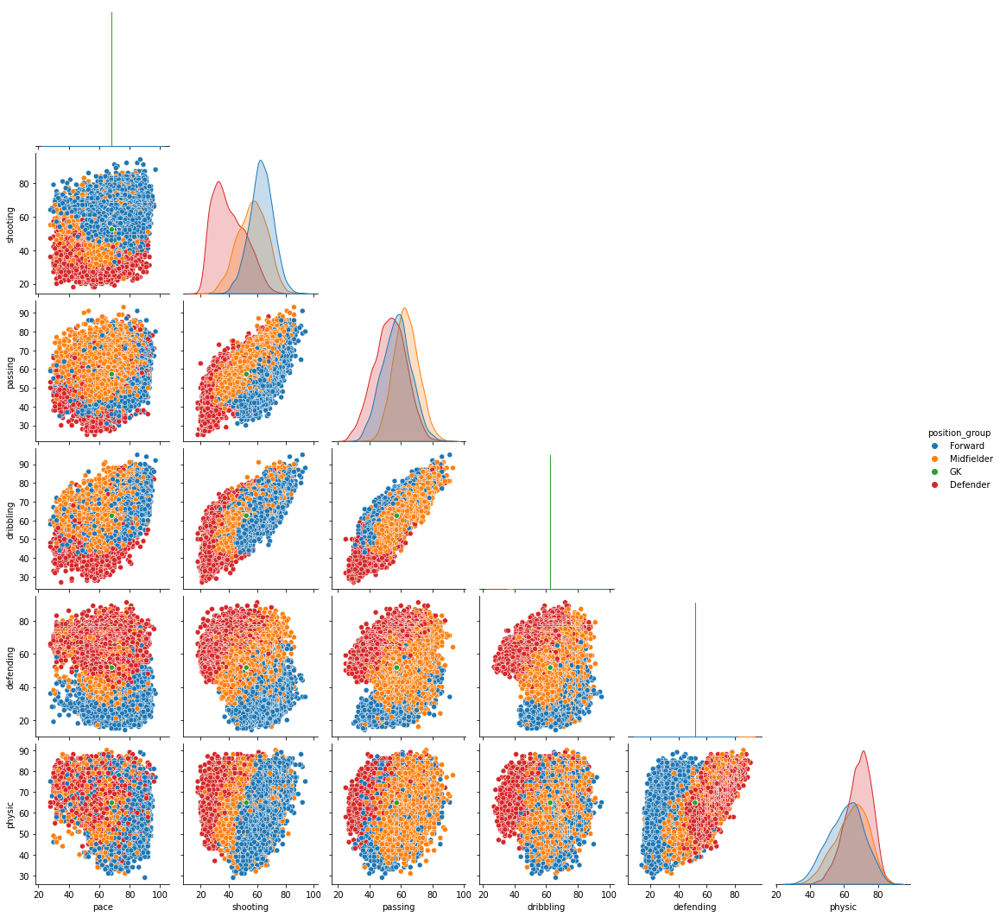

In [94]:
#dat = df_numerical_columns.join(position)

col = ['pace', 'shooting', 'passing',
       'dribbling', 'defending', 'physic']
dat = df_numerical_columns[col]
dat = dat.join(position)
fig = plt.figure(figsize=(10,10))
sns.pairplot(dat, hue='position_group', corner=True)
plt.savefig('pairplot_1.jpg', bbox_inches = 'tight')

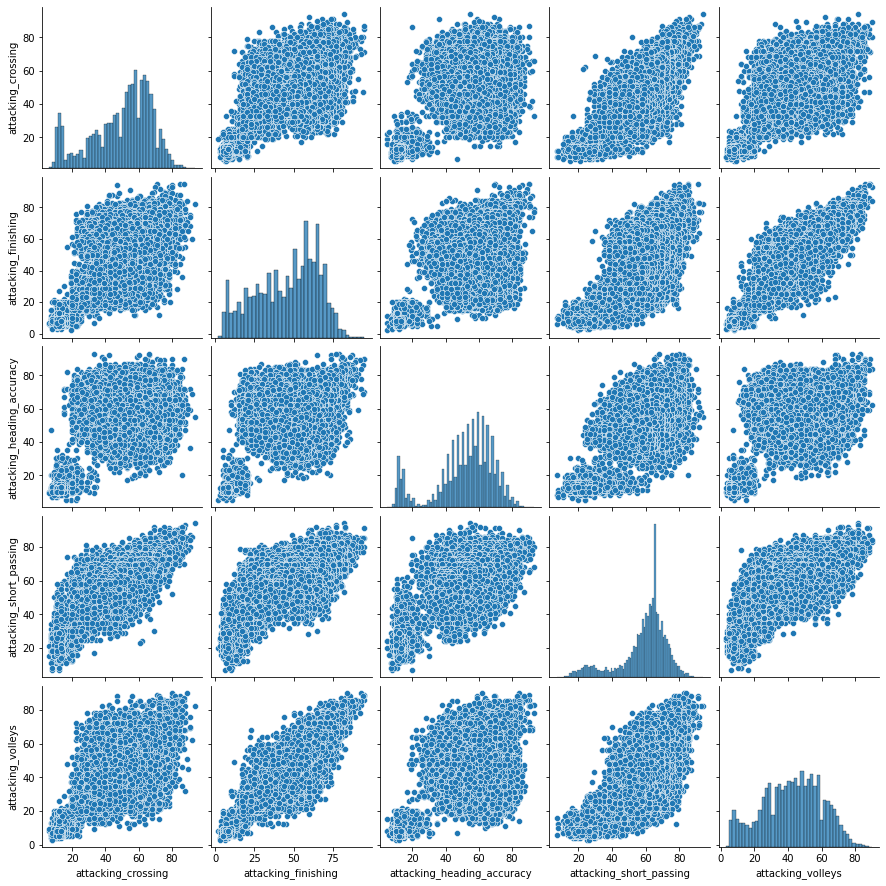

In [95]:
col = ['attacking_crossing',
       'attacking_finishing', 'attacking_heading_accuracy',
       'attacking_short_passing', 'attacking_volleys']
dat = df_numerical_columns[col]
sns.pairplot(dat)

<Figure size 720x720 with 0 Axes>

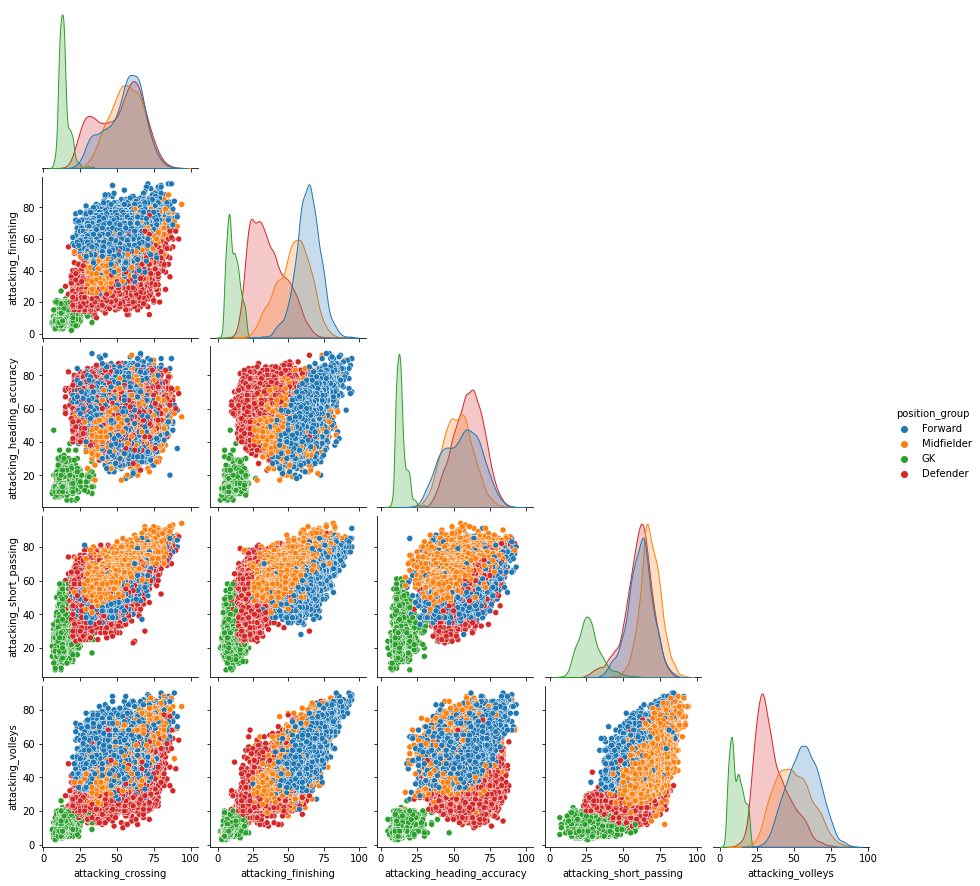

In [96]:
col = ['attacking_crossing',
       'attacking_finishing', 'attacking_heading_accuracy',
       'attacking_short_passing', 'attacking_volleys']
dat = df_numerical_columns[col]
dat = dat.join(position)
fig = plt.figure(figsize=(10,10))
sns.pairplot(dat, hue='position_group', corner=True)
plt.savefig('pairplot_2.jpg', bbox_inches = 'tight')

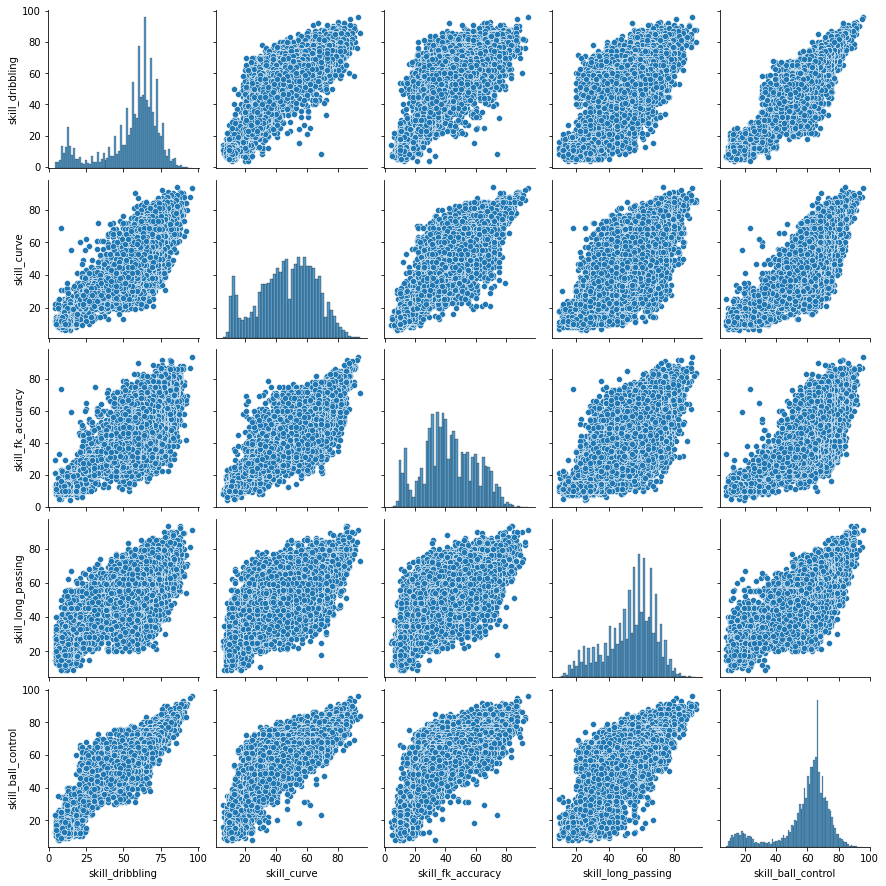

In [97]:
col = ['skill_dribbling',
       'skill_curve', 'skill_fk_accuracy', 'skill_long_passing',
       'skill_ball_control']
dat = df_numerical_columns[col]
sns.pairplot(dat)

<Figure size 720x720 with 0 Axes>

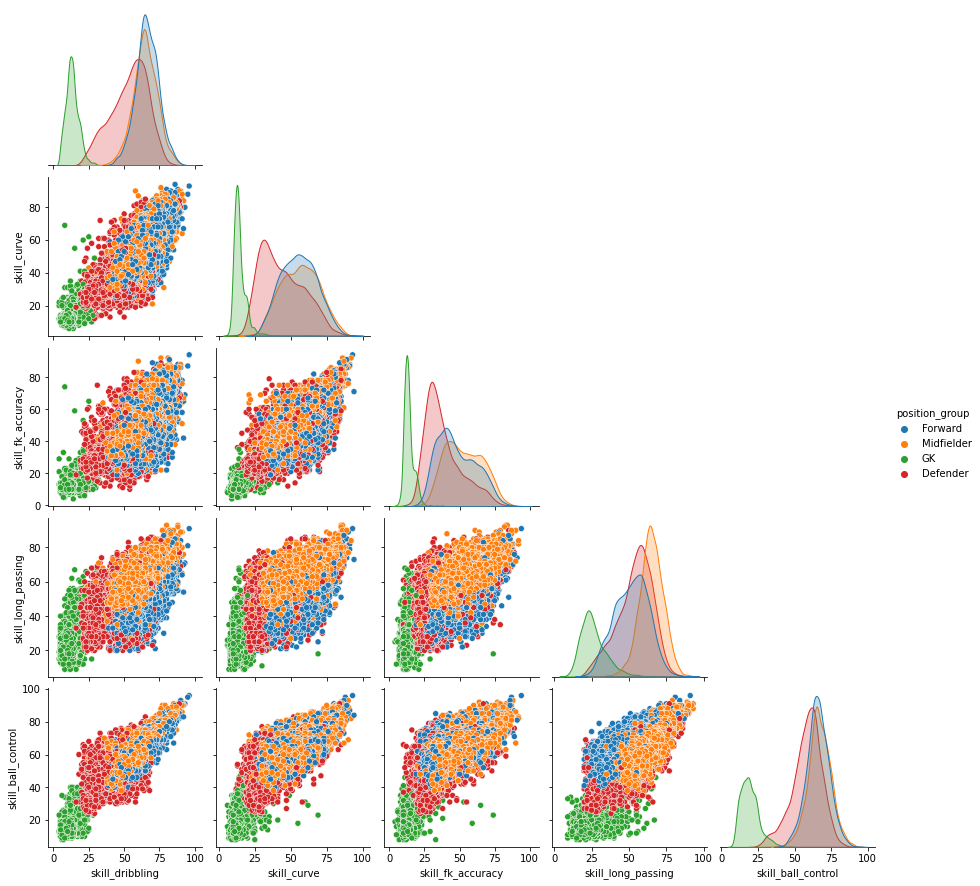

In [98]:
col = ['skill_dribbling',
       'skill_curve', 'skill_fk_accuracy', 'skill_long_passing',
       'skill_ball_control']
dat = df_numerical_columns[col]
dat = dat.join(position)
fig = plt.figure(figsize=(10,10))
sns.pairplot(dat, hue='position_group', corner=True)
plt.savefig('pairplot_3.jpg', bbox_inches = 'tight')

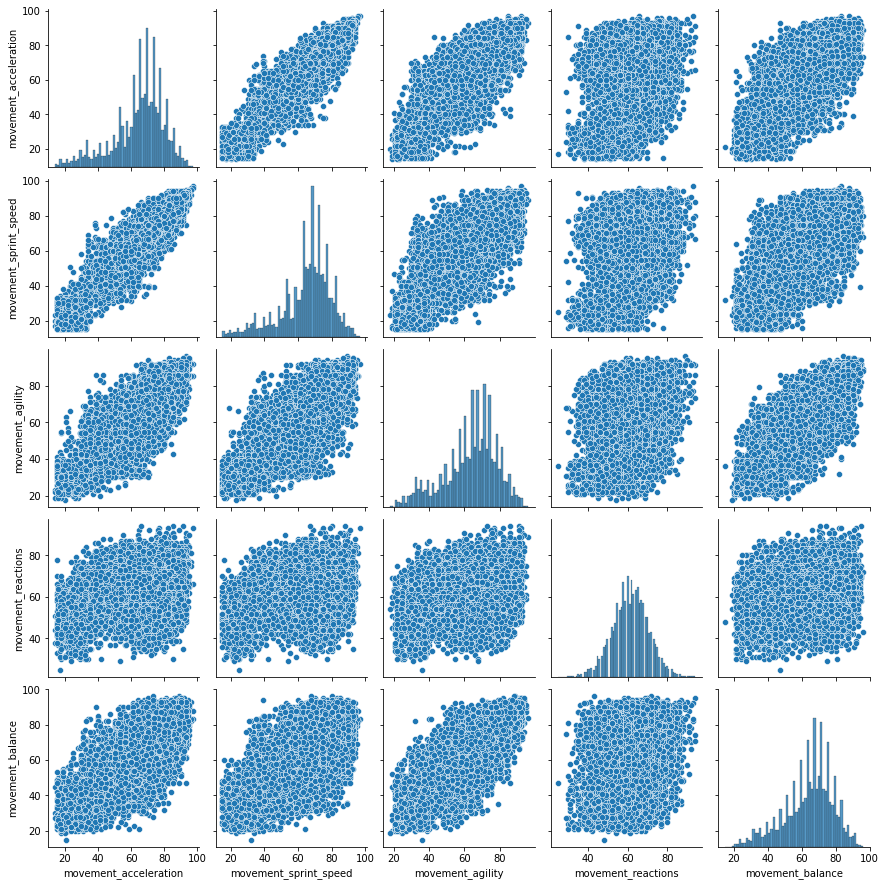

In [99]:
col = ['movement_acceleration', 'movement_sprint_speed',
       'movement_agility', 'movement_reactions', 'movement_balance']
dat = df_numerical_columns[col]
sns.pairplot(dat)

<Figure size 720x720 with 0 Axes>

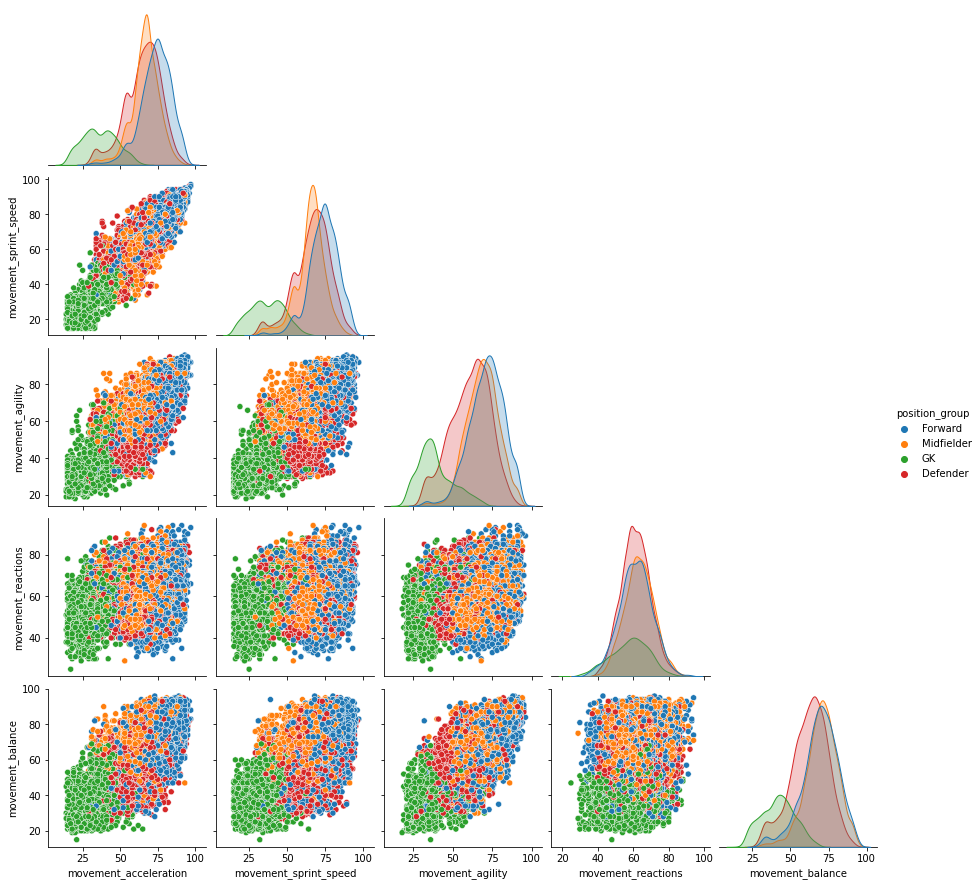

In [100]:
col = ['movement_acceleration', 'movement_sprint_speed',
       'movement_agility', 'movement_reactions', 'movement_balance']
dat = df_numerical_columns[col]
dat = dat.join(position)
fig = plt.figure(figsize=(10,10))
sns.pairplot(dat, hue='position_group', corner=True)
plt.savefig('pairplot_4.jpg', bbox_inches = 'tight')

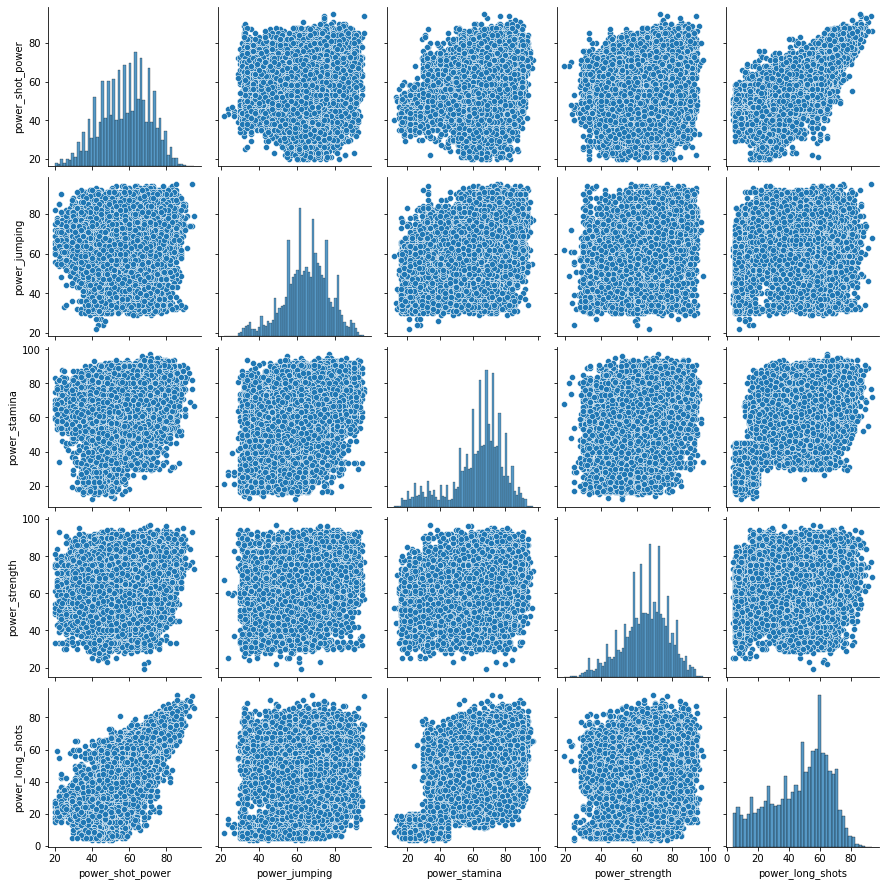

In [101]:
col = ['power_shot_power', 'power_jumping', 'power_stamina', 'power_strength',
       'power_long_shots']
dat = df_numerical_columns[col]
sns.pairplot(dat)

<Figure size 720x720 with 0 Axes>

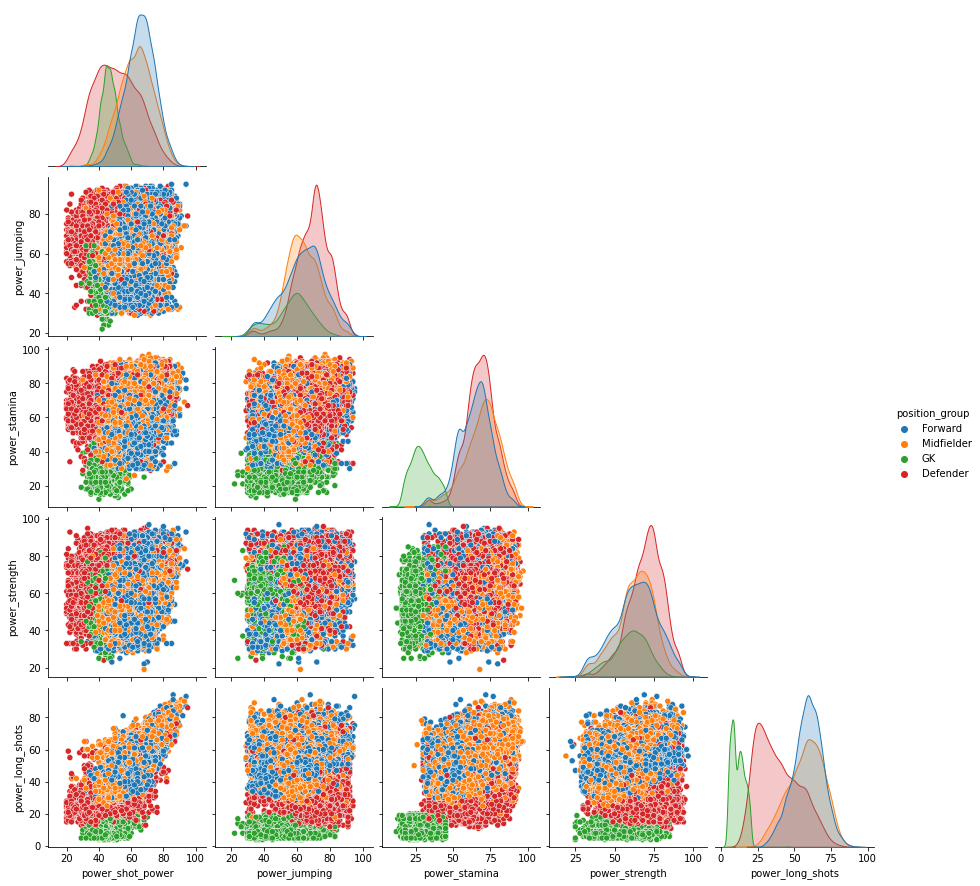

In [102]:
col = ['power_shot_power', 'power_jumping', 'power_stamina', 'power_strength',
       'power_long_shots']
dat = df_numerical_columns[col]
dat = dat.join(position)
fig = plt.figure(figsize=(10,10))
sns.pairplot(dat, hue='position_group', corner=True)
plt.savefig('pairplot_5.jpg', bbox_inches = 'tight')

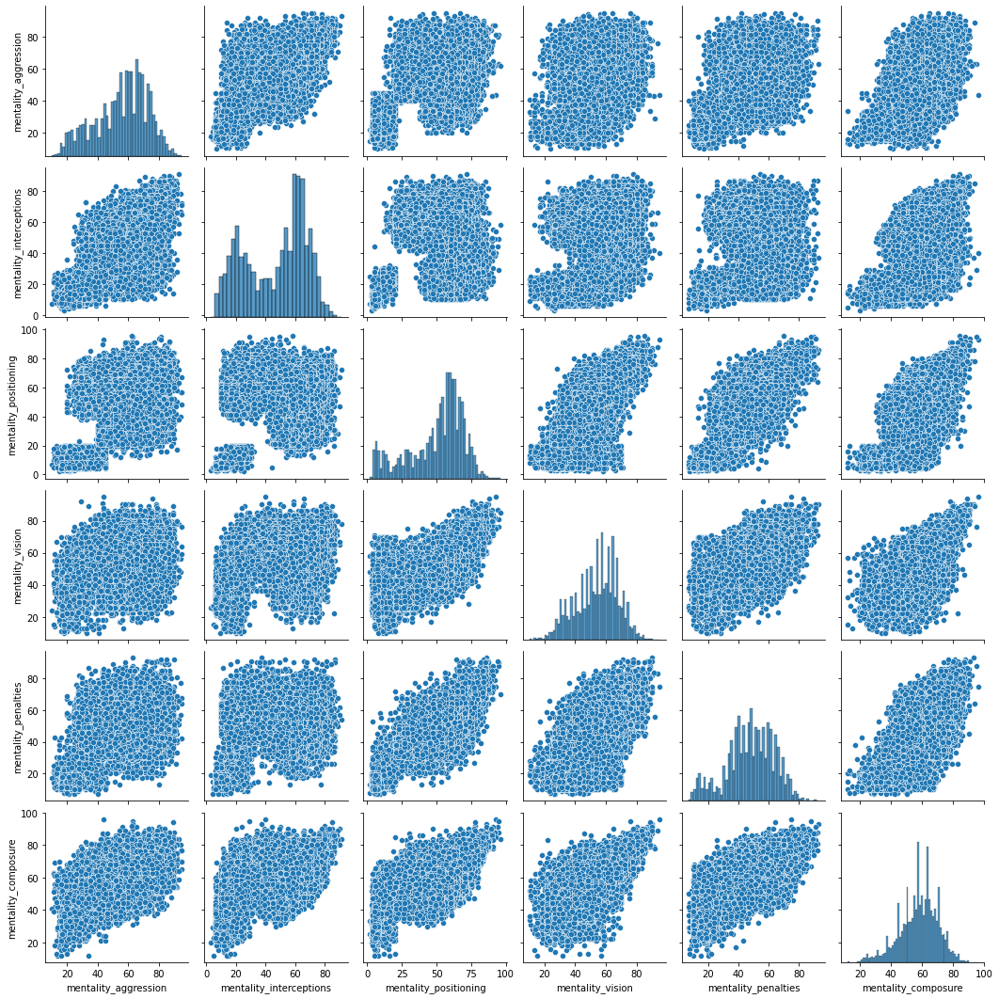

In [103]:
col = ['mentality_aggression', 'mentality_interceptions',
       'mentality_positioning', 'mentality_vision', 'mentality_penalties',
       'mentality_composure']
dat = df_numerical_columns[col]
sns.pairplot(dat)

<Figure size 720x720 with 0 Axes>

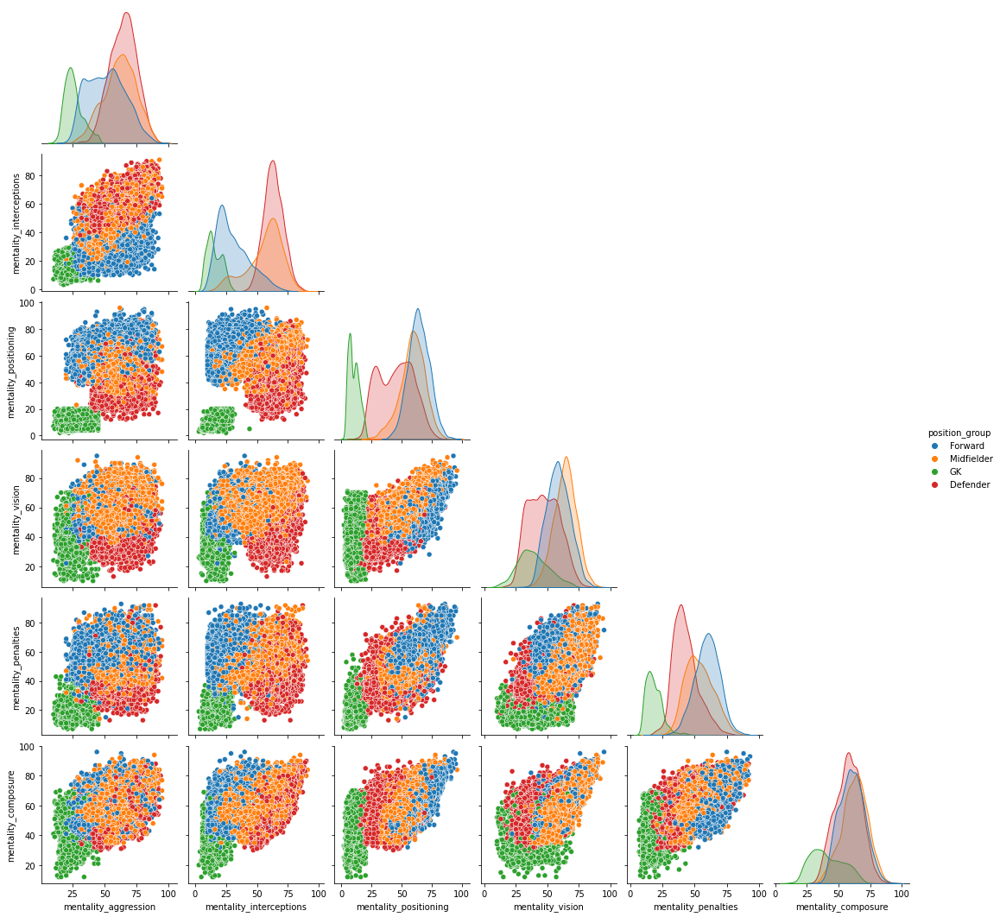

In [104]:
col = ['mentality_aggression', 'mentality_interceptions',
       'mentality_positioning', 'mentality_vision', 'mentality_penalties',
       'mentality_composure']
dat = df_numerical_columns[col]
dat = dat.join(position)
fig = plt.figure(figsize=(10,10))
sns.pairplot(dat, hue='position_group', corner=True)
plt.savefig('pairplot_6.jpg', bbox_inches = 'tight')

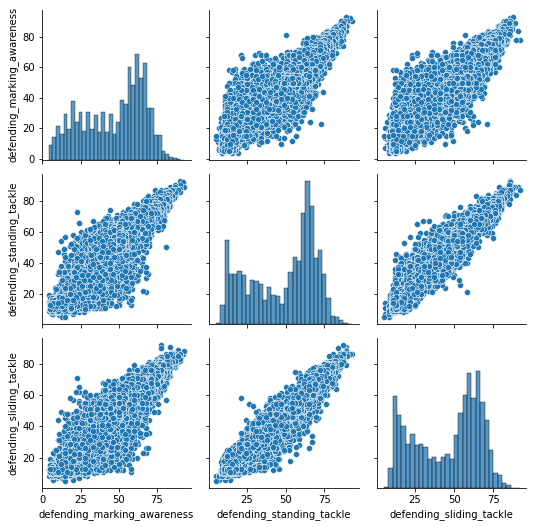

In [105]:
col = ['defending_marking_awareness',
       'defending_standing_tackle', 'defending_sliding_tackle']
dat = df_numerical_columns[col]
sns.pairplot(dat)

<Figure size 720x720 with 0 Axes>

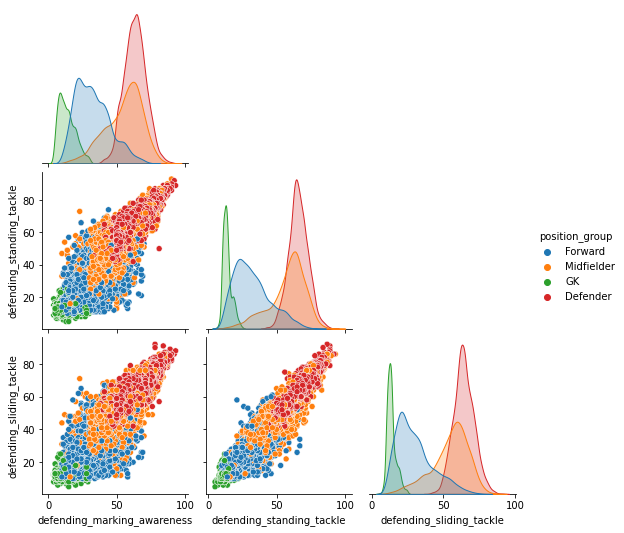

In [106]:
col = ['defending_marking_awareness',
       'defending_standing_tackle', 'defending_sliding_tackle']
dat = df_numerical_columns[col]
dat = dat.join(position)
fig = plt.figure(figsize=(10,10))
sns.pairplot(dat, hue='position_group', corner=True)
plt.savefig('pairplot_7.jpg', bbox_inches = 'tight')

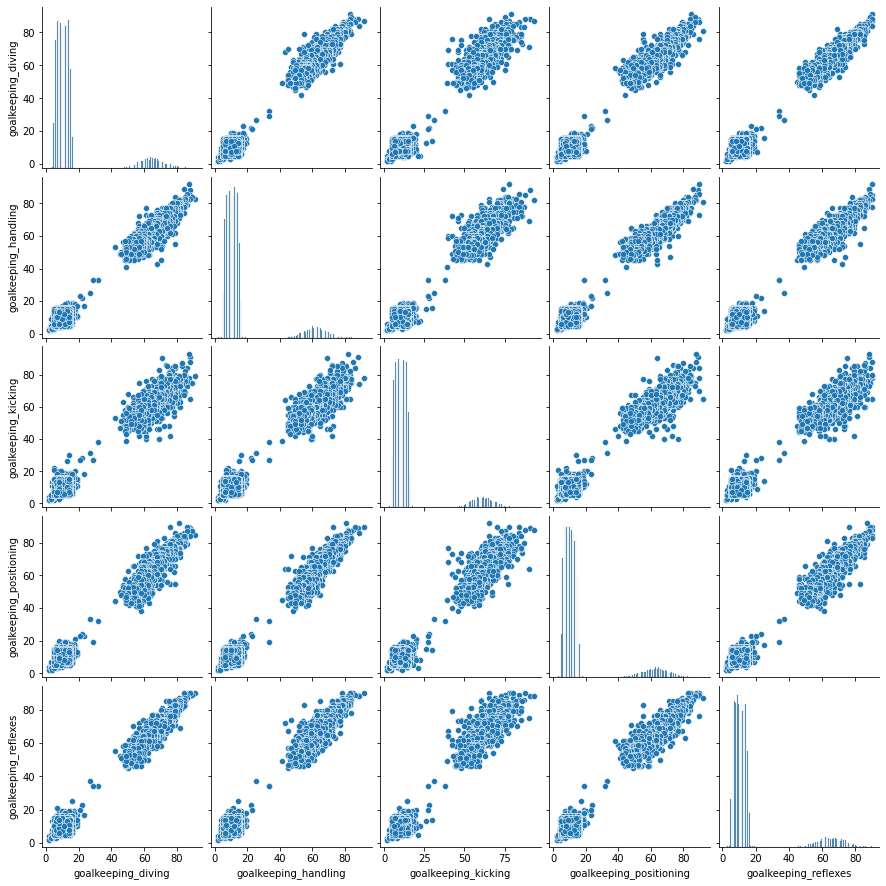

In [107]:
col = ['goalkeeping_diving', 'goalkeeping_handling', 'goalkeeping_kicking',
       'goalkeeping_positioning', 'goalkeeping_reflexes']
dat = df_numerical_columns[col]
sns.pairplot(dat)

<Figure size 720x720 with 0 Axes>

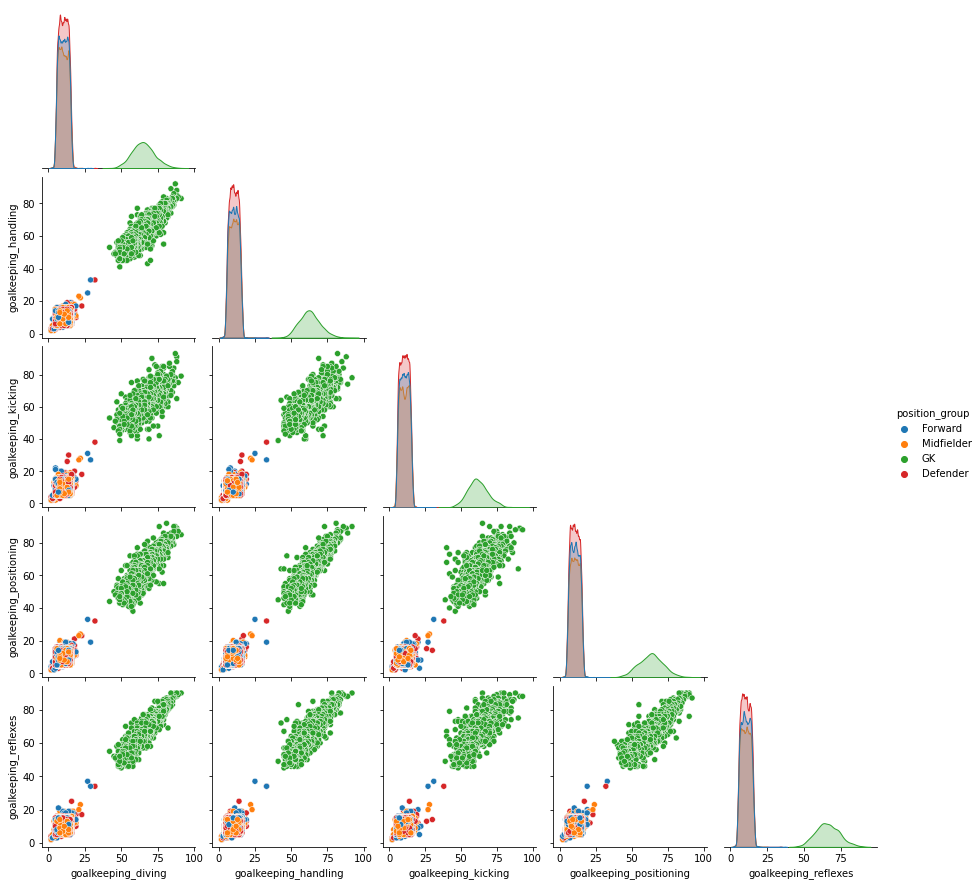

In [108]:
col = ['goalkeeping_diving', 'goalkeeping_handling', 'goalkeeping_kicking',
       'goalkeeping_positioning', 'goalkeeping_reflexes']
dat = df_numerical_columns[col]
dat = dat.join(position)
fig = plt.figure(figsize=(10,10))
sns.pairplot(dat, hue='position_group', corner=True)
plt.savefig('pairplot_8.jpg', bbox_inches = 'tight')

# 3) Uso de dos técnicas de clustering

In [109]:
#n=10000 #cantidad de jugadores a considerar

#df_n=data.loc[:n] #se reduce la base a los n primeros jugadores
df_n = data

#df_n=df_n[(df_n['overall']>70)]

skills_ratings = ['pace', 'shooting', 'passing',
       'dribbling', 'defending', 'physic', 'attacking_crossing',
       'attacking_finishing', 'attacking_heading_accuracy',
       'attacking_short_passing', 'attacking_volleys', 'skill_dribbling',
       'skill_curve', 'skill_fk_accuracy', 'skill_long_passing',
       'skill_ball_control', 'movement_acceleration', 'movement_sprint_speed',
       'movement_agility', 'movement_reactions', 'movement_balance',
       'power_shot_power', 'power_jumping', 'power_stamina', 'power_strength',
       'power_long_shots', 'mentality_aggression', 'mentality_interceptions',
       'mentality_positioning', 'mentality_vision', 'mentality_penalties',
       'mentality_composure', 'defending_marking_awareness',
       'defending_standing_tackle', 'defending_sliding_tackle',
       'goalkeeping_diving', 'goalkeeping_handling', 'goalkeeping_kicking',
       'goalkeeping_positioning', 'goalkeeping_reflexes']
print(len(skills_ratings), 'variables numéricas de desempeño según habilidad')

40 variables numéricas de desempeño según habilidad


In [110]:
MachineGunDict={'short_name':'MachineGun','overall':99}
for skills in skills_ratings:
    MachineGunDict[skills]=99
    
df_n=df_n.append(MachineGunDict,ignore_index=True)

In [111]:
JugadorPromedioDict={'short_name':'JugadorPromedio','overall':df_n.overall.mean()}
for skills in skills_ratings:
    JugadorPromedioDict[skills]=df_n[skills].mean()
    
df_n=df_n.append(JugadorPromedioDict,ignore_index=True)

In [138]:
df_skills=df_n[skills_ratings] #base, sólo con desempeños según habilidad (numéricas)

In [139]:
df_skills.head(4)

,pace,shooting,passing,dribbling,defending,physic,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes
0,85.0,92.0,91.0,95.0,34.0,65.0,85.0,95.0,70.0,91.0,88.0,96.0,93.0,94.0,91.0,96.0,91.0,80.0,91.0,94.0,95.0,86.0,68.0,72.0,69.0,94.0,44.0,40.0,93.0,95.0,75.0,96.0,20.0,35.0,24.0,6.0,11.0,15.0,14.0,8.0
1,78.0,92.0,79.0,86.0,44.0,82.0,71.0,95.0,90.0,85.0,89.0,85.0,79.0,85.0,70.0,88.0,77.0,79.0,77.0,93.0,82.0,90.0,85.0,76.0,86.0,87.0,81.0,49.0,95.0,81.0,90.0,88.0,35.0,42.0,19.0,15.0,6.0,12.0,8.0,10.0
2,87.0,94.0,80.0,88.0,34.0,75.0,87.0,95.0,90.0,80.0,86.0,88.0,81.0,84.0,77.0,88.0,85.0,88.0,86.0,94.0,74.0,94.0,95.0,77.0,77.0,93.0,63.0,29.0,95.0,76.0,88.0,95.0,24.0,32.0,24.0,7.0,11.0,15.0,14.0,11.0
3,91.0,83.0,86.0,94.0,37.0,63.0,85.0,83.0,63.0,86.0,86.0,95.0,88.0,87.0,81.0,95.0,93.0,89.0,96.0,89.0,84.0,80.0,64.0,81.0,53.0,81.0,63.0,37.0,86.0,90.0,93.0,93.0,35.0,32.0,29.0,9.0,9.0,15.0,15.0,11.0


In [140]:
# Scaling the data to bring all the attributes to a comparable level

scaler = StandardScaler()
df_skills_scaled = scaler.fit_transform(df_skills)
  
# Normalizing the data so that 
# the data approximately follows a Gaussian distribution
df_skills_normalized = normalize(df_skills_scaled)
  
# Converting the numpy array into a pandas DataFrame

df_skills_normalized = pd.DataFrame(df_skills_normalized, columns = skills_ratings)


In [142]:
df_numeric_normalized = df_skills_normalized.copy()
df_skills_normalized=df_skills_normalized.join(df_n[categorical_variables])

In [143]:
df_skills_normalized.head(4)

,pace,shooting,passing,dribbling,defending,physic,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,sofifa_id,player_url,short_name,long_name,player_positions,dob,club_team_id,club_name,league_name,league_level,club_position,club_jersey_number,club_joined,club_contract_valid_until,nationality_id,nationality_name,preferred_foot,weak_foot,skill_moves,international_reputation,work_rate,body_type,real_face,ls,st,rs,lw,lf,cf,rf,rw,lam,cam,ram,lm,lcm,cm,rcm,rm,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb,gk,player_face_url,club_logo_url,club_flag_url,nation_flag_url,position_group
0,0.128905,0.236913,0.280818,0.282137,-0.091825,0.001500,0.155503,0.197141,0.083386,0.175554,0.204206,0.170031,0.199139,0.238487,0.199823,0.178309,0.137536,0.080863,0.146499,0.284927,0.170962,0.169366,0.020800,0.043714,0.024950,0.193153,-0.053842,-0.025336,0.172176,0.237982,0.136257,0.247859,-0.104278,-0.048659,-0.083580,-0.046884,-0.024424,-0.005063,-0.010362,-0.037599,158023,https://sofifa.com/player/158023/lionel-messi/...,L. Messi,Lionel Andrés Messi Cuccittini,"RW, ST, CF",1987-06-24,73.0,Paris Saint-Germain,French Ligue 1,1.0,RW,30.0,2021-08-10,2023.0,52,Argentina,Left,4,4,5,Medium/Low,Unique,Yes,89+3,89+3,89+3,92,93,93,93,92,93,93,93,91+2,87+3,87+3,87+3,91+2,66+3,64+3,64+3,64+3,66+3,61+3,50+3,50+3,50+3,61+3,19+3,https://cdn.sofifa.net/players/158/023/22_120.png,https://cdn.sofifa.net/teams/73/60.png,https://cdn.sofifa.net/flags/fr.png,https://cdn.sofifa.net/flags/ar.png,Forward
1,0.085139,0.268412,0.204815,0.230958,-0.045278,0.166830,0.106542,0.223352,0.198211,0.161753,0.236437,0.140105,0.156542,0.223203,0.101034,0.158949,0.073018,0.085620,0.081473,0.312892,0.112282,0.219081,0.149354,0.071751,0.148690,0.186485,0.134561,0.010342,0.204211,0.177631,0.239697,0.221800,-0.051532,-0.025554,-0.116302,-0.007196,-0.054294,-0.021975,-0.043276,-0.032570,188545,https://sofifa.com/player/188545/robert-lewand...,R. Lewandowski,Robert Lewandowski,ST,1988-08-21,21.0,FC Bayern München,German 1. Bundesliga,1.0,ST,9.0,2014-07-01,2023.0,37,Poland,Right,4,4,5,High/Medium,Unique,Yes,90+2,90+2,90+2,85,88,88,88,85,86+3,86+3,86+3,84+3,80+3,80+3,80+3,84+3,64+3,66+3,66+3,66+3,64+3,61+3,60+3,60+3,60+3,61+3,19+3,https://cdn.sofifa.net/players/188/545/22_120.png,https://cdn.sofifa.net/teams/21/60.png,https://cdn.sofifa.net/flags/de.png,https://cdn.sofifa.net/flags/pl.png,Forward
2,0.154112,0.265849,0.202025,0.236352,-0.098093,0.093191,0.175496,0.210597,0.186892,0.123332,0.208562,0.145613,0.156907,0.205533,0.134664,0.149872,0.113462,0.131599,0.128042,0.304375,0.058632,0.232214,0.210593,0.072893,0.080086,0.201979,0.037172,-0.072062,0.192549,0.136509,0.215282,0.257821,-0.094647,-0.063931,-0.089285,-0.045273,-0.026091,-0.005408,-0.011069,-0.025983,20801,https://sofifa.com/player/20801/c-ronaldo-dos-...,Cristiano Ronaldo,Cristiano Ronaldo dos Santos Aveiro,"ST, LW",1985-02-05,11.0,Manchester United,English Premier League,1.0,ST,7.0,2021-08-27,2023.0,38,Portugal,Right,4,5,5,High/Low,Unique,Yes,90+1,90+1,90+1,88,89,89,89,88,86+3,86+3,86+3,86+3,78+3,78+3,78+3,86+3,63+3,59+3,59+3,59+3,63+3,60+3,53+3,53+3,53+3,60+3,20+3,https://cdn.sofifa.net/players/020/801/22_120.png,https://cdn.sofifa.net/teams/11/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://cdn.sofifa.net/flags/pt.png,Forward
3,0.191244,0.200159,0.261358,0.298850,-0.083354,-0.017102,0.169953,0.162806,0.056110,0.162010,0.2

En las siguientes lineas se pueden ir visualizando la conformación de clusters de a dos variables nuéricas (o skills)

In [117]:
for i in enumerate(skills_ratings):
  print(i)

(0, 'pace')
(1, 'shooting')
(2, 'passing')
(3, 'dribbling')
(4, 'defending')
(5, 'physic')
(6, 'attacking_crossing')
(7, 'attacking_finishing')
(8, 'attacking_heading_accuracy')
(9, 'attacking_short_passing')
(10, 'attacking_volleys')
(11, 'skill_dribbling')
(12, 'skill_curve')
(13, 'skill_fk_accuracy')
(14, 'skill_long_passing')
(15, 'skill_ball_control')
(16, 'movement_acceleration')
(17, 'movement_sprint_speed')
(18, 'movement_agility')
(19, 'movement_reactions')
(20, 'movement_balance')
(21, 'power_shot_power')
(22, 'power_jumping')
(23, 'power_stamina')
(24, 'power_strength')
(25, 'power_long_shots')
(26, 'mentality_aggression')
(27, 'mentality_interceptions')
(28, 'mentality_positioning')
(29, 'mentality_vision')
(30, 'mentality_penalties')
(31, 'mentality_composure')
(32, 'defending_marking_awareness')
(33, 'defending_standing_tackle')
(34, 'defending_sliding_tackle')
(35, 'goalkeeping_diving')
(36, 'goalkeeping_handling')
(37, 'goalkeeping_kicking')
(38, 'goalkeeping_positionin

In [118]:
#data=[]
bool_crack=df_n["overall"] > 85 #diferenciamos a los mejores jugadores

#Elejimos dos variables, para esto elegimos dos números entre 0 y  de n_skills-1
skill_1=skills_ratings[8] #5,  2
skill_2=skills_ratings[10]  #29, 4 

In [119]:
bool_crack=df_n["overall"] > 85
graf1 = go.Scatter(x=df_skills_normalized[skill_1], y=df_skills_normalized[skill_2],
                           mode='markers',
                        text=df_n.loc[:,'position_group'], #'value_eur', 'wage_eur', 'age', 'height_cm', 'weight_kg','club_name','league_name', 'nationality_name'
                           marker=dict(
                                size=5)
                           )

crack =go.Scatter(x=df_skills_normalized.loc[bool_crack,skill_1], y=df_skills_normalized.loc[bool_crack,skill_2],name='Top players',
                      text=df_n.loc[bool_crack,'short_name'],
                      textfont=dict(family='sans serif',size=10,color='black'),
                      opacity=0.9,mode='text')

data=[graf1,crack]

layout = go.Layout(title="Visualización de la base de a dos variables numéricas",titlefont=dict(size=20),
                xaxis=dict(title=skill_1),
                yaxis=dict(title=skill_2),
                autosize=False, width=1000,height=650)

fig = go.Figure(data=data, layout=layout)

In [120]:
fig.show(renderer="colab")

In [121]:
#En Jupyter Ntb abre en otra ventana, 
#plot(fig)

In [122]:
#en Jupyter Ntb, abre en la ntb
#iplot(fig)

In [123]:
# Número de clusters buscado
n_clust = 4

km = KMeans(n_clusters=n_clust)
km.fit(df_skills_normalized[skills_ratings]) #utiliza todas las habilidades: 34 dimensiones

# Etiquetas asignadas por el algoritmo
clusters = km.labels_
#print('Suma de los cuadrados de las distancias al centro de cada cluster=Inertia= ', km.inertia_)

In [124]:
df_clusters=df_skills_normalized.copy()
df_clusters['kmeans_4'] = km.labels_ #clusters
print('Kmeans encontró: ', max(km.labels_)+1, 'clusters, nosotros forzamos la cantidad')
df_clusters.head(4)

Kmeans encontró:  4 clusters, nosotros forzamos la cantidad


,pace,shooting,passing,dribbling,defending,physic,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,sofifa_id,player_url,short_name,long_name,player_positions,dob,club_team_id,club_name,league_name,league_level,club_position,club_jersey_number,club_joined,club_contract_valid_until,nationality_id,nationality_name,preferred_foot,weak_foot,skill_moves,international_reputation,work_rate,body_type,real_face,ls,st,rs,lw,lf,cf,rf,rw,lam,cam,ram,lm,lcm,cm,rcm,rm,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb,gk,player_face_url,club_logo_url,club_flag_url,nation_flag_url,position_group,kmeans_4
0,0.128905,0.236913,0.280818,0.282137,-0.091825,0.001500,0.155503,0.197141,0.083386,0.175554,0.204206,0.170031,0.199139,0.238487,0.199823,0.178309,0.137536,0.080863,0.146499,0.284927,0.170962,0.169366,0.020800,0.043714,0.024950,0.193153,-0.053842,-0.025336,0.172176,0.237982,0.136257,0.247859,-0.104278,-0.048659,-0.083580,-0.046884,-0.024424,-0.005063,-0.010362,-0.037599,158023,https://sofifa.com/player/158023/lionel-messi/...,L. Messi,Lionel Andrés Messi Cuccittini,"RW, ST, CF",1987-06-24,73.0,Paris Saint-Germain,French Ligue 1,1.0,RW,30.0,2021-08-10,2023.0,52,Argentina,Left,4,4,5,Medium/Low,Unique,Yes,89+3,89+3,89+3,92,93,93,93,92,93,93,93,91+2,87+3,87+3,87+3,91+2,66+3,64+3,64+3,64+3,66+3,61+3,50+3,50+3,50+3,61+3,19+3,https://cdn.sofifa.net/players/158/023/22_120.png,https://cdn.sofifa.net/teams/73/60.png,https://cdn.sofifa.net/flags/fr.png,https://cdn.sofifa.net/flags/ar.png,Forward,2
1,0.085139,0.268412,0.204815,0.230958,-0.045278,0.166830,0.106542,0.223352,0.198211,0.161753,0.236437,0.140105,0.156542,0.223203,0.101034,0.158949,0.073018,0.085620,0.081473,0.312892,0.112282,0.219081,0.149354,0.071751,0.148690,0.186485,0.134561,0.010342,0.204211,0.177631,0.239697,0.221800,-0.051532,-0.025554,-0.116302,-0.007196,-0.054294,-0.021975,-0.043276,-0.032570,188545,https://sofifa.com/player/188545/robert-lewand...,R. Lewandowski,Robert Lewandowski,ST,1988-08-21,21.0,FC Bayern München,German 1. Bundesliga,1.0,ST,9.0,2014-07-01,2023.0,37,Poland,Right,4,4,5,High/Medium,Unique,Yes,90+2,90+2,90+2,85,88,88,88,85,86+3,86+3,86+3,84+3,80+3,80+3,80+3,84+3,64+3,66+3,66+3,66+3,64+3,61+3,60+3,60+3,60+3,61+3,19+3,https://cdn.sofifa.net/players/188/545/22_120.png,https://cdn.sofifa.net/teams/21/60.png,https://cdn.sofifa.net/flags/de.png,https://cdn.sofifa.net/flags/pl.png,Forward,2
2,0.154112,0.265849,0.202025,0.236352,-0.098093,0.093191,0.175496,0.210597,0.186892,0.123332,0.208562,0.145613,0.156907,0.205533,0.134664,0.149872,0.113462,0.131599,0.128042,0.304375,0.058632,0.232214,0.210593,0.072893,0.080086,0.201979,0.037172,-0.072062,0.192549,0.136509,0.215282,0.257821,-0.094647,-0.063931,-0.089285,-0.045273,-0.026091,-0.005408,-0.011069,-0.025983,20801,https://sofifa.com/player/20801/c-ronaldo-dos-...,Cristiano Ronaldo,Cristiano Ronaldo dos Santos Aveiro,"ST, LW",1985-02-05,11.0,Manchester United,English Premier League,1.0,ST,7.0,2021-08-27,2023.0,38,Portugal,Right,4,5,5,High/Low,Unique,Yes,90+1,90+1,90+1,88,89,89,89,88,86+3,86+3,86+3,86+3,78+3,78+3,78+3,86+3,63+3,59+3,59+3,59+3,63+3,60+3,53+3,53+3,53+3,60+3,20+3,https://cdn.sofifa.net/players/020/801/22_120.png,https://cdn.sofifa.net/teams/11/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://cdn.sofifa.net/flags/pt.png,Forward,2
3,0.191244,0.200159,0.261358,0.298850,-0.083354,-0.017102,0.169953,0.162806,0.0561

In [125]:
bool_crack=df_n["overall"] > 85
bool_no_crack=df_n["overall"]<86

#Eligo dos números entre 0 y  de n_skills-1
skill_1=skills_ratings[8]
skill_2=skills_ratings[10]

In [126]:
kmean_clusters = go.Scatter(x=df_skills_normalized[skill_1], y=df_skills_normalized[skill_2],
                           mode='markers',
                        text=df_n.loc[:,'position_group'],
                           marker=dict(
                                size=5,
                                color = clusters.astype(np.float), #set color equal to a variable
                                colorscale='Portland',
                                showscale=False)
                           )

crack =go.Scatter(x=df_skills_normalized.loc[bool_crack,skill_1], y=df_skills_normalized.loc[bool_crack,skill_2],name='Ckacks!!',
                      text=df_n.loc[bool_crack,'short_name'],
                      textfont=dict(family='sans serif',size=10,color='black'),
                      opacity=0.9,mode='text')

data=[kmean_clusters,crack]

layout = go.Layout(title="Clustering K means ",titlefont=dict(size=20),
                xaxis=dict(title=skill_1),
                yaxis=dict(title=skill_2),
                autosize=False, width=1000,height=650)

fig = go.Figure(data=data, layout=layout)

In [127]:
#En Colab:
fig.show(renderer="colab")

In [128]:
#En Jupyter:
#iplot(fig)
#plot(fig)

Text(0.5, 1.0, 'Inertia of k-Means versus number of clusters')

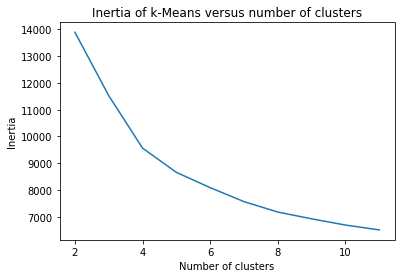

In [129]:
#Prueba: para elegir el hiperparámetro n_clusters, variando de 2 a 11 clusters
scores = [KMeans(n_clusters=i).fit(df_skills_normalized[skills_ratings]).inertia_ for i in range(2,12)]

plt.plot(np.arange(2, 12), scores)
plt.xlabel('Number of clusters')
plt.ylabel("Inertia")
plt.title("Inertia of k-Means versus number of clusters")

In [130]:
from sklearn.cluster import DBSCAN
import numpy as np
#DBSCAN_cluster = DBSCAN(eps=50, min_samples=10).fit(df_skills) 


In [131]:
# Numpy array of all the cluster labels assigned to each data point
db_default = DBSCAN(eps = 0.375, min_samples =10).fit(df_skills_normalized[skills_ratings])
#core_samples_mask = np.zeros_like(db_default.labels_, dtype=bool)
#core_samples_mask[db_default.core_sample_indices_] = True
labels = db_default.labels_

In [132]:
# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
n_noise_ = list(labels).count(-1)

print("Estimated number of clusters: %d" % n_clusters_)
print("Estimated number of noise points: %d" % n_noise_)

Estimated number of clusters: 4
Estimated number of noise points: 11447


In [133]:
labels

array([ 0,  0,  0, ..., -1, -1, -1])

In [134]:
#df_clusters=df_n.copy()
df_clusters['dbscan'] = db_default.labels_ #clusters
print('Dbscan encontró: ', max(db_default.labels_), 'clusters')
df_clusters.head(4)

Dbscan encontró:  3 clusters


,pace,shooting,passing,dribbling,defending,physic,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,sofifa_id,player_url,short_name,long_name,player_positions,dob,club_team_id,club_name,league_name,league_level,club_position,club_jersey_number,club_joined,club_contract_valid_until,nationality_id,nationality_name,preferred_foot,weak_foot,skill_moves,international_reputation,work_rate,body_type,real_face,ls,st,rs,lw,lf,cf,rf,rw,lam,cam,ram,lm,lcm,cm,rcm,rm,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb,gk,player_face_url,club_logo_url,club_flag_url,nation_flag_url,position_group,kmeans_4,dbscan
0,0.128905,0.236913,0.280818,0.282137,-0.091825,0.001500,0.155503,0.197141,0.083386,0.175554,0.204206,0.170031,0.199139,0.238487,0.199823,0.178309,0.137536,0.080863,0.146499,0.284927,0.170962,0.169366,0.020800,0.043714,0.024950,0.193153,-0.053842,-0.025336,0.172176,0.237982,0.136257,0.247859,-0.104278,-0.048659,-0.083580,-0.046884,-0.024424,-0.005063,-0.010362,-0.037599,158023,https://sofifa.com/player/158023/lionel-messi/...,L. Messi,Lionel Andrés Messi Cuccittini,"RW, ST, CF",1987-06-24,73.0,Paris Saint-Germain,French Ligue 1,1.0,RW,30.0,2021-08-10,2023.0,52,Argentina,Left,4,4,5,Medium/Low,Unique,Yes,89+3,89+3,89+3,92,93,93,93,92,93,93,93,91+2,87+3,87+3,87+3,91+2,66+3,64+3,64+3,64+3,66+3,61+3,50+3,50+3,50+3,61+3,19+3,https://cdn.sofifa.net/players/158/023/22_120.png,https://cdn.sofifa.net/teams/73/60.png,https://cdn.sofifa.net/flags/fr.png,https://cdn.sofifa.net/flags/ar.png,Forward,2,0
1,0.085139,0.268412,0.204815,0.230958,-0.045278,0.166830,0.106542,0.223352,0.198211,0.161753,0.236437,0.140105,0.156542,0.223203,0.101034,0.158949,0.073018,0.085620,0.081473,0.312892,0.112282,0.219081,0.149354,0.071751,0.148690,0.186485,0.134561,0.010342,0.204211,0.177631,0.239697,0.221800,-0.051532,-0.025554,-0.116302,-0.007196,-0.054294,-0.021975,-0.043276,-0.032570,188545,https://sofifa.com/player/188545/robert-lewand...,R. Lewandowski,Robert Lewandowski,ST,1988-08-21,21.0,FC Bayern München,German 1. Bundesliga,1.0,ST,9.0,2014-07-01,2023.0,37,Poland,Right,4,4,5,High/Medium,Unique,Yes,90+2,90+2,90+2,85,88,88,88,85,86+3,86+3,86+3,84+3,80+3,80+3,80+3,84+3,64+3,66+3,66+3,66+3,64+3,61+3,60+3,60+3,60+3,61+3,19+3,https://cdn.sofifa.net/players/188/545/22_120.png,https://cdn.sofifa.net/teams/21/60.png,https://cdn.sofifa.net/flags/de.png,https://cdn.sofifa.net/flags/pl.png,Forward,2,0
2,0.154112,0.265849,0.202025,0.236352,-0.098093,0.093191,0.175496,0.210597,0.186892,0.123332,0.208562,0.145613,0.156907,0.205533,0.134664,0.149872,0.113462,0.131599,0.128042,0.304375,0.058632,0.232214,0.210593,0.072893,0.080086,0.201979,0.037172,-0.072062,0.192549,0.136509,0.215282,0.257821,-0.094647,-0.063931,-0.089285,-0.045273,-0.026091,-0.005408,-0.011069,-0.025983,20801,https://sofifa.com/player/20801/c-ronaldo-dos-...,Cristiano Ronaldo,Cristiano Ronaldo dos Santos Aveiro,"ST, LW",1985-02-05,11.0,Manchester United,English Premier League,1.0,ST,7.0,2021-08-27,2023.0,38,Portugal,Right,4,5,5,High/Low,Unique,Yes,90+1,90+1,90+1,88,89,89,89,88,86+3,86+3,86+3,86+3,78+3,78+3,78+3,86+3,63+3,59+3,59+3,59+3,63+3,60+3,53+3,53+3,53+3,60+3,20+3,https://cdn.sofifa.net/players/020/801/22_120.png,https://cdn.sofifa.net/teams/11/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://cdn.sofifa.net/flags/pt.png,Forward,2,0
3,0.191244,0.200159,0.261358,0.298850,-0.083354,-0.017102,0.169953,0.

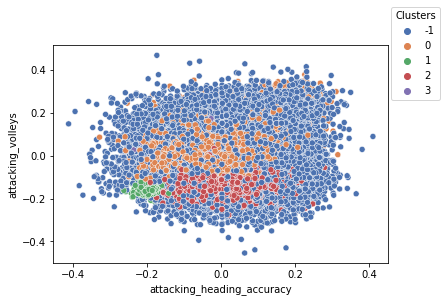

In [135]:
#import seaborn as sns
#import matplotlib.pyplot as plt
p = sns.scatterplot(data=df_skills_normalized[skills_ratings], x=df_skills_normalized[skill_1], y=df_skills_normalized[skill_2], hue=db_default.labels_, legend="full", palette="deep")
sns.move_legend(p, "upper right", bbox_to_anchor=(1.17, 1.2), title='Clusters')
plt.show()


In [144]:
#Step 4: Reducing the dimensionality of the data to make it visualizable

pca = PCA(n_components = 2)
X_principal = pca.fit_transform(df_numeric_normalized)
X_principal = pd.DataFrame(X_principal)
X_principal.columns = ['P1', 'P2']
print(X_principal.head())



         P1        P2
0 -0.831278  0.237766
1 -0.798217  0.058349
2 -0.796625  0.178198
3 -0.839942  0.243140
4 -0.839836 -0.114213


In [146]:
df_with_pca = df_skills_normalized.join(X_principal)

,pace,shooting,passing,dribbling,defending,physic,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,sofifa_id,player_url,short_name,long_name,player_positions,dob,club_team_id,club_name,league_name,league_level,club_position,club_jersey_number,club_joined,club_contract_valid_until,nationality_id,nationality_name,preferred_foot,weak_foot,skill_moves,international_reputation,work_rate,body_type,real_face,ls,st,rs,lw,lf,cf,rf,rw,lam,cam,ram,lm,lcm,cm,rcm,rm,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb,gk,player_face_url,club_logo_url,club_flag_url,nation_flag_url,position_group,P1,P2
0,0.128905,0.236913,0.280818,0.282137,-0.091825,0.001500,0.155503,0.197141,0.083386,0.175554,0.204206,0.170031,0.199139,0.238487,0.199823,0.178309,0.137536,0.080863,0.146499,0.284927,0.170962,0.169366,0.020800,0.043714,0.024950,0.193153,-0.053842,-0.025336,0.172176,0.237982,0.136257,0.247859,-0.104278,-0.048659,-0.083580,-0.046884,-0.024424,-0.005063,-0.010362,-0.037599,158023,https://sofifa.com/player/158023/lionel-messi/...,L. Messi,Lionel Andrés Messi Cuccittini,"RW, ST, CF",1987-06-24,73.0,Paris Saint-Germain,French Ligue 1,1.0,RW,30.0,2021-08-10,2023.0,52,Argentina,Left,4,4,5,Medium/Low,Unique,Yes,89+3,89+3,89+3,92,93,93,93,92,93,93,93,91+2,87+3,87+3,87+3,91+2,66+3,64+3,64+3,64+3,66+3,61+3,50+3,50+3,50+3,61+3,19+3,https://cdn.sofifa.net/players/158/023/22_120.png,https://cdn.sofifa.net/teams/73/60.png,https://cdn.sofifa.net/flags/fr.png,https://cdn.sofifa.net/flags/ar.png,Forward,-0.831278,0.237766
1,0.085139,0.268412,0.204815,0.230958,-0.045278,0.166830,0.106542,0.223352,0.198211,0.161753,0.236437,0.140105,0.156542,0.223203,0.101034,0.158949,0.073018,0.085620,0.081473,0.312892,0.112282,0.219081,0.149354,0.071751,0.148690,0.186485,0.134561,0.010342,0.204211,0.177631,0.239697,0.221800,-0.051532,-0.025554,-0.116302,-0.007196,-0.054294,-0.021975,-0.043276,-0.032570,188545,https://sofifa.com/player/188545/robert-lewand...,R. Lewandowski,Robert Lewandowski,ST,1988-08-21,21.0,FC Bayern München,German 1. Bundesliga,1.0,ST,9.0,2014-07-01,2023.0,37,Poland,Right,4,4,5,High/Medium,Unique,Yes,90+2,90+2,90+2,85,88,88,88,85,86+3,86+3,86+3,84+3,80+3,80+3,80+3,84+3,64+3,66+3,66+3,66+3,64+3,61+3,60+3,60+3,60+3,61+3,19+3,https://cdn.sofifa.net/players/188/545/22_120.png,https://cdn.sofifa.net/teams/21/60.png,https://cdn.sofifa.net/flags/de.png,https://cdn.sofifa.net/flags/pl.png,Forward,-0.798217,0.058349
2,0.154112,0.265849,0.202025,0.236352,-0.098093,0.093191,0.175496,0.210597,0.186892,0.123332,0.208562,0.145613,0.156907,0.205533,0.134664,0.149872,0.113462,0.131599,0.128042,0.304375,0.058632,0.232214,0.210593,0.072893,0.080086,0.201979,0.037172,-0.072062,0.192549,0.136509,0.215282,0.257821,-0.094647,-0.063931,-0.089285,-0.045273,-0.026091,-0.005408,-0.011069,-0.025983,20801,https://sofifa.com/player/20801/c-ronaldo-dos-...,Cristiano Ronaldo,Cristiano Ronaldo dos Santos Aveiro,"ST, LW",1985-02-05,11.0,Manchester United,English Premier League,1.0,ST,7.0,2021-08-27,2023.0,38,Portugal,Right,4,5,5,High/Low,Unique,Yes,90+1,90+1,90+1,88,89,89,89,88,86+3,86+3,86+3,86+3,78+3,78+3,78+3,86+3,63+3,59+3,59+3,59+3,63+3,60+3,53+3,53+3,53+3,60+3,20+3,https://cdn.sofifa.net/players/020/801/22_120.png,https://cdn.sofifa.net/teams/11/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://cdn.sofifa.net/flags/pt.png,Forward,-0.796625,0.178198
3,0.191244,0.200159,0.261358,0.298

In [151]:
kmean_clusters = go.Scatter(x=df_with_pca["P1"], y=df_with_pca["P2"],
                           mode='markers',
                        text=df_n.loc[:,'position_group'],
                           marker=dict(
                                size=5,
                                color = clusters.astype(np.float), #set color equal to a variable
                                colorscale='Portland',
                                showscale=False)
                           )

crack =go.Scatter(x=df_with_pca.loc[bool_crack,"P1"], y=df_with_pca.loc[bool_crack,"P2"],name='Ckacks!!',
                      text=df_n.loc[bool_crack,'short_name'],
                      textfont=dict(family='sans serif',size=10,color='black'),
                      opacity=0.9,mode='text')

data=[kmean_clusters,crack]

layout = go.Layout(title="Reducción de dimensionalidad con PSA",titlefont=dict(size=20),
                xaxis=dict(title="P1"),
                yaxis=dict(title="P2"),
                autosize=False, width=1000,height=650)

fig = go.Figure(data=data, layout=layout)

In [152]:
#En Colab:
fig.show(renderer="colab")

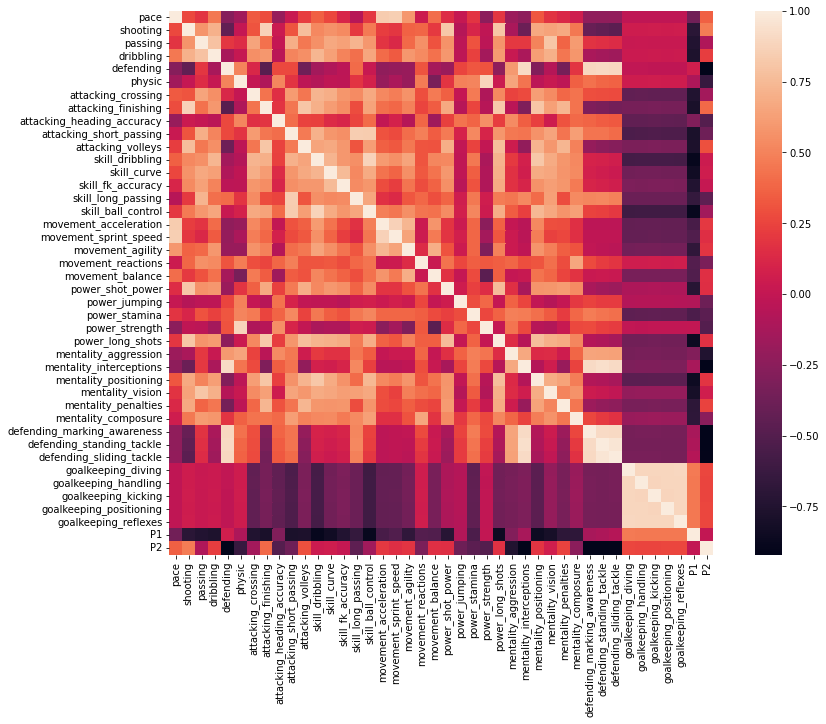

In [153]:
fig = plt.figure(figsize=(15,10))
sns.heatmap(df_numeric_normalized.join(X_principal).corr(),square=True)
plt.savefig('corr_matrix.jpg', bbox_inches = 'tight')

Que las columnas P1 y P2 tengan tan poca correlación con cualquiera de las otras variables, estaría significando que no es sencillo determinar el rol de un jugador en base a sus skills viendo solo una skill. Va a ser necesario hacer una combinación lineal de varias (con PSA por ejemplo) para recien poder ver esa separación de forma contundente.